In [1]:
import pandas as pd

# Veri setini okuma
file_path = "C:\\Users\\alisa\\Desktop\\Acoustic Features.csv"
df = pd.read_csv(file_path)

# İlk birkaç satırı görüntüleme
df.head()


,Class,_RMSenergy_Mean,_Lowenergy_Mean,_Fluctuation_Mean,_Tempo_Mean,_MFCC_Mean_1,_MFCC_Mean_2,_MFCC_Mean_3,_MFCC_Mean_4,_MFCC_Mean_5,...,_Chromagram_Mean_9,_Chromagram_Mean_10,_Chromagram_Mean_11,_Chromagram_Mean_12,_HarmonicChangeDetectionFunction_Mean,_HarmonicChangeDetectionFunction_Std,_HarmonicChangeDetectionFunction_Slope,_HarmonicChangeDetectionFunction_PeriodFreq,_HarmonicChangeDetectionFunction_PeriodAmp,_HarmonicChangeDetectionFunction_PeriodEntropy
0,relax,0.052,0.591,9.136,130.043,3.997,0.363,0.887,0.078,0.221,...,0.426,1.000,0.008,0.101,0.316,0.261,0.018,1.035,0.593,0.970
1,relax,0.125,0.439,6.680,142.240,4.058,0.516,0.785,0.397,0.556,...,0.002,1.000,0.000,0.984,0.285,0.211,-0.082,3.364,0.702,0.967
2,relax,0.046,0.639,10.578,188.154,2.775,0.903,0.502,0.329,0.287,...,0.184,0.746,0.016,1.000,0.413,0.299,0.134,1.682,0.692,0.963
3,relax,0.135,0.603,10.442,65.991,2.841,1.552,0.612,0.351,0.011,...,0.038,1.000,0.161,0.757,0.422,0.265,0.042,0.354,0.743,0.968
4,relax,0.066,0.591,9.769,88.890,3.217,0.228,0.814,0.096,0.434,...,0.004,0.404,1.000,0.001,0.345,0.261,0.089,0.748,0.674,0.957


In [2]:
# Eksik değerleri kontrol etme
print(df.isnull().sum())

# Eksik değerleri kaldırma
df = df.dropna()

# Verinin genel bilgilerini görüntüleme
df.info()

# Veri setindeki kategorik verileri ve sayısal verileri ayırma
categorical_columns = df.select_dtypes(include=['object']).columns
numerical_columns = df.select_dtypes(include=['number']).columns

print("Categorical columns:", categorical_columns)
print("Numerical columns:", numerical_columns)


Class                                             0
_RMSenergy_Mean                                   0
_Lowenergy_Mean                                   0
_Fluctuation_Mean                                 0
_Tempo_Mean                                       0
_MFCC_Mean_1                                      0
_MFCC_Mean_2                                      0
_MFCC_Mean_3                                      0
_MFCC_Mean_4                                      0
_MFCC_Mean_5                                      0
_MFCC_Mean_6                                      0
_MFCC_Mean_7                                      0
_MFCC_Mean_8                                      0
_MFCC_Mean_9                                      0
_MFCC_Mean_10                                     0
_MFCC_Mean_11                                     0
_MFCC_Mean_12                                     0
_MFCC_Mean_13                                     0
_Roughness_Mean                                   0
_Roughness_S

In [3]:
# Veri setinin sütun isimlerini görüntüleme
print(df.columns)


Index(['Class', '_RMSenergy_Mean', '_Lowenergy_Mean', '_Fluctuation_Mean',
       '_Tempo_Mean', '_MFCC_Mean_1', '_MFCC_Mean_2', '_MFCC_Mean_3',
       '_MFCC_Mean_4', '_MFCC_Mean_5', '_MFCC_Mean_6', '_MFCC_Mean_7',
       '_MFCC_Mean_8', '_MFCC_Mean_9', '_MFCC_Mean_10', '_MFCC_Mean_11',
       '_MFCC_Mean_12', '_MFCC_Mean_13', '_Roughness_Mean', '_Roughness_Slope',
       '_Zero-crossingrate_Mean', '_AttackTime_Mean', '_AttackTime_Slope',
       '_Rolloff_Mean', '_Eventdensity_Mean', '_Pulseclarity_Mean',
       '_Brightness_Mean', '_Spectralcentroid_Mean', '_Spectralspread_Mean',
       '_Spectralskewness_Mean', '_Spectralkurtosis_Mean',
       '_Spectralflatness_Mean', '_EntropyofSpectrum_Mean',
       '_Chromagram_Mean_1', '_Chromagram_Mean_2', '_Chromagram_Mean_3',
       '_Chromagram_Mean_4', '_Chromagram_Mean_5', '_Chromagram_Mean_6',
       '_Chromagram_Mean_7', '_Chromagram_Mean_8', '_Chromagram_Mean_9',
       '_Chromagram_Mean_10', '_Chromagram_Mean_11', '_Chromagram_Mean_12

In [4]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix

# Doğru hedef sütunu belirleme
target_column = 'Class'

# Özellikler ve hedef değişkeni ayırma
X = df.drop(target_column, axis=1)
y = df[target_column]

# Veri setini eğitim ve test seti olarak ayırma
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Model oluşturma ve eğitme
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

# Tahmin yapma
y_pred = rf.predict(X_test)

# Sonuçları değerlendirme
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))


[[15  2  1  0]
 [ 0 17  0  1]
 [ 0  0 21  5]
 [ 1  2  2 13]]
              precision    recall  f1-score   support

       angry       0.94      0.83      0.88        18
       happy       0.81      0.94      0.87        18
       relax       0.88      0.81      0.84        26
         sad       0.68      0.72      0.70        18

    accuracy                           0.82        80
   macro avg       0.83      0.83      0.82        80
weighted avg       0.83      0.82      0.83        80



In [5]:
from sklearn.neighbors import KNeighborsClassifier

# Model oluşturma ve eğitme
knn = KNeighborsClassifier(n_neighbors=5)
knn.fit(X_train, y_train)

# Tahmin yapma
y_pred_knn = knn.predict(X_test)

# Sonuçları değerlendirme
print(confusion_matrix(y_test, y_pred_knn))
print(classification_report(y_test, y_pred_knn))


[[ 6  3  6  3]
 [ 2 12  1  3]
 [ 7  0 11  8]
 [ 5  7  3  3]]
              precision    recall  f1-score   support

       angry       0.30      0.33      0.32        18
       happy       0.55      0.67      0.60        18
       relax       0.52      0.42      0.47        26
         sad       0.18      0.17      0.17        18

    accuracy                           0.40        80
   macro avg       0.39      0.40      0.39        80
weighted avg       0.40      0.40      0.40        80



In [6]:
from sklearn.linear_model import LogisticRegression

# Model oluşturma ve eğitme
logreg = LogisticRegression(max_iter=1000)
logreg.fit(X_train, y_train)

# Tahmin yapma
y_pred_logreg = logreg.predict(X_test)

# Sonuçları değerlendirme
print(confusion_matrix(y_test, y_pred_logreg))
print(classification_report(y_test, y_pred_logreg))


[[ 9  1  5  3]
 [ 0 17  1  0]
 [ 1  0 16  9]
 [ 4  4  2  8]]
              precision    recall  f1-score   support

       angry       0.64      0.50      0.56        18
       happy       0.77      0.94      0.85        18
       relax       0.67      0.62      0.64        26
         sad       0.40      0.44      0.42        18

    accuracy                           0.62        80
   macro avg       0.62      0.63      0.62        80
weighted avg       0.63      0.62      0.62        80



C:\ProgramData\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [7]:
from sklearn.tree import DecisionTreeClassifier

# Model oluşturma ve eğitme
dt = DecisionTreeClassifier(random_state=42)
dt.fit(X_train, y_train)

# Tahmin yapma
y_pred_dt = dt.predict(X_test)

# Sonuçları değerlendirme
print(confusion_matrix(y_test, y_pred_dt))
print(classification_report(y_test, y_pred_dt))


[[10  2  4  2]
 [ 2 14  0  2]
 [ 1  3 14  8]
 [ 1  2  4 11]]
              precision    recall  f1-score   support

       angry       0.71      0.56      0.63        18
       happy       0.67      0.78      0.72        18
       relax       0.64      0.54      0.58        26
         sad       0.48      0.61      0.54        18

    accuracy                           0.61        80
   macro avg       0.62      0.62      0.62        80
weighted avg       0.63      0.61      0.61        80



In [8]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Doğru hedef sütunu belirleme
target_column = 'Class'

# Özellikler ve hedef değişkeni ayırma
X = df.drop(target_column, axis=1)
y = df[target_column]

# Hedef değişkeni etiketleme
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

# Veri setini eğitim ve test seti olarak ayırma
X_train, X_test, y_train, y_test = train_test_split(X, y_encoded, test_size=0.2, random_state=42)

# Veriyi ölçekleme
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Model oluşturma ve eğitme
lr = LinearRegression()
lr.fit(X_train_scaled, y_train)

# Tahmin yapma
y_pred_lr = lr.predict(X_test_scaled)

# Sonuçları değerlendirme
mse = mean_squared_error(y_test, y_pred_lr)
print("Mean Squared Error:", mse)


Mean Squared Error: 0.6214231539191284


In [9]:
from sklearn.linear_model import LogisticRegression

# Model oluşturma ve eğitme
logreg = LogisticRegression(max_iter=2000, solver='saga')
logreg.fit(X_train_scaled, y_train)

# Tahmin yapma
y_pred_logreg = logreg.predict(X_test_scaled)

# Sonuçları değerlendirme
print(confusion_matrix(y_test, y_pred_logreg))
print(classification_report(y_test, y_pred_logreg))


[[14  1  2  1]
 [ 0 17  1  0]
 [ 3  0 18  5]
 [ 2  2  3 11]]
              precision    recall  f1-score   support

           0       0.74      0.78      0.76        18
           1       0.85      0.94      0.89        18
           2       0.75      0.69      0.72        26
           3       0.65      0.61      0.63        18

    accuracy                           0.75        80
   macro avg       0.75      0.76      0.75        80
weighted avg       0.75      0.75      0.75        80



In [10]:
from sklearn.naive_bayes import GaussianNB

# Model oluşturma ve eğitme
nb = GaussianNB()
nb.fit(X_train, y_train)

# Tahmin yapma
y_pred_nb = nb.predict(X_test)

# Sonuçları değerlendirme
print(confusion_matrix(y_test, y_pred_nb))
print(classification_report(y_test, y_pred_nb))


[[11  5  1  1]
 [ 1 16  0  1]
 [ 1  0 21  4]
 [ 4  4  4  6]]
              precision    recall  f1-score   support

           0       0.65      0.61      0.63        18
           1       0.64      0.89      0.74        18
           2       0.81      0.81      0.81        26
           3       0.50      0.33      0.40        18

    accuracy                           0.68        80
   macro avg       0.65      0.66      0.65        80
weighted avg       0.66      0.68      0.66        80



[[14  1  2  1]
 [ 0 17  1  0]
 [ 3  0 18  5]
 [ 2  2  3 11]]
              precision    recall  f1-score   support

           0       0.74      0.78      0.76        18
           1       0.85      0.94      0.89        18
           2       0.75      0.69      0.72        26
           3       0.65      0.61      0.63        18

    accuracy                           0.75        80
   macro avg       0.75      0.76      0.75        80
weighted avg       0.75      0.75      0.75        80



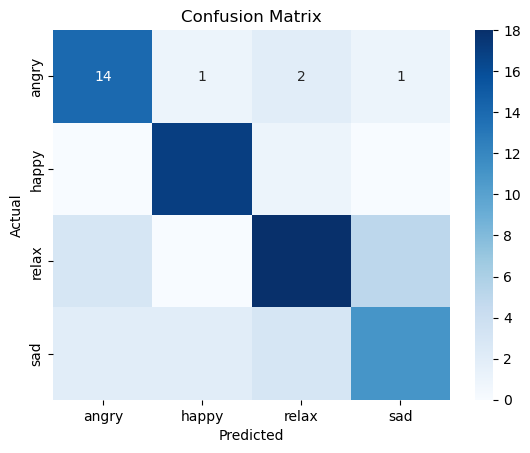

In [11]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Doğru hedef sütunu belirleme
target_column = 'Class'

# Özellikler ve hedef değişkeni ayırma
X = df.drop(target_column, axis=1)
y = df[target_column]

# Hedef değişkeni etiketleme
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

# Veri setini eğitim ve test seti olarak ayırma
X_train, X_test, y_train, y_test = train_test_split(X, y_encoded, test_size=0.2, random_state=42)

# Veriyi ölçekleme
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Model oluşturma ve eğitme
logreg = LogisticRegression(max_iter=2000, solver='saga')
logreg.fit(X_train_scaled, y_train)

# Tahmin yapma
y_pred_logreg = logreg.predict(X_test_scaled)

# Sonuçları değerlendirme
print(confusion_matrix(y_test, y_pred_logreg))
print(classification_report(y_test, y_pred_logreg))

# Confusion matrix görselleştirme
conf_matrix = confusion_matrix(y_test, y_pred_logreg)
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()


In [12]:
import pandas as pd

# Veri setini okuma
file_path = "C:\\Users\\alisa\\Desktop\\Acoustic Features.csv"
df = pd.read_csv(file_path)

# Veri setinin sütun isimlerini ve veri tiplerini görüntüleme
print("Veri setinin sütun isimleri ve veri tipleri:")
print(df.dtypes)

# Veri setinin ilk birkaç satırını görüntüleme
print("\nVeri setinin ilk 5 satırı:")
print(df.head())

# Veri setinin özet istatistiklerini görüntüleme
print("\nVeri setinin özet istatistikleri:")
print(df.describe())


Veri setinin sütun isimleri ve veri tipleri:
Class                                              object
_RMSenergy_Mean                                   float64
_Lowenergy_Mean                                   float64
_Fluctuation_Mean                                 float64
_Tempo_Mean                                       float64
_MFCC_Mean_1                                      float64
_MFCC_Mean_2                                      float64
_MFCC_Mean_3                                      float64
_MFCC_Mean_4                                      float64
_MFCC_Mean_5                                      float64
_MFCC_Mean_6                                      float64
_MFCC_Mean_7                                      float64
_MFCC_Mean_8                                      float64
_MFCC_Mean_9                                      float64
_MFCC_Mean_10                                     float64
_MFCC_Mean_11                                     float64
_MFCC_Mean_12              

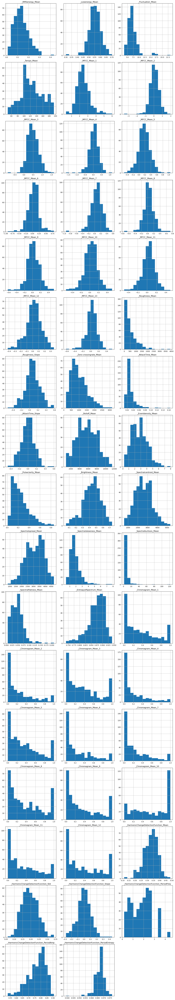

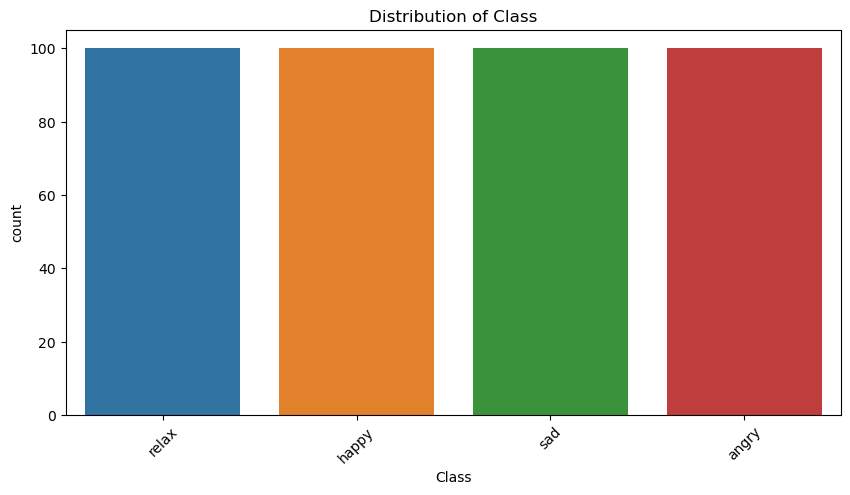

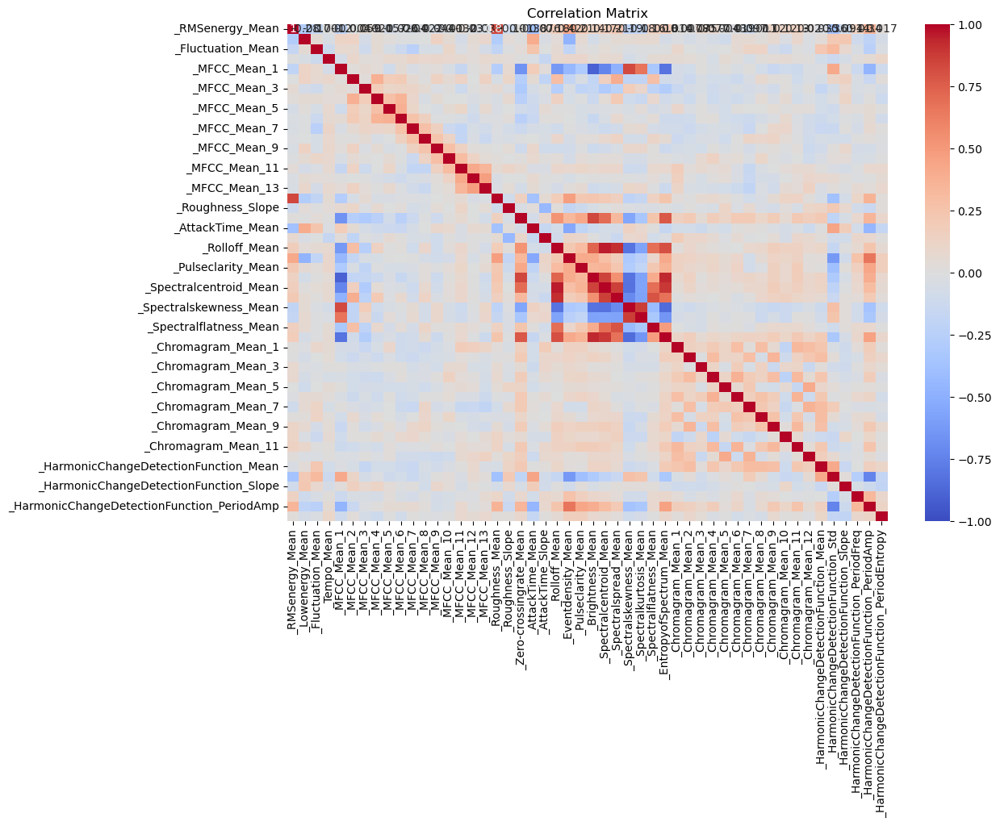

In [13]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math

# Veri setini okuma
file_path = "C:\\Users\\alisa\\Desktop\\Acoustic Features.csv"
df = pd.read_csv(file_path)

# Sütun türlerini belirleme
categorical_columns = df.select_dtypes(include=['object']).columns
numerical_columns = df.select_dtypes(include=['number']).columns

# Sayısal değişkenlerin histogramlarını çizme
num_columns = len(numerical_columns)
num_rows = math.ceil(num_columns / 3)

fig, axes = plt.subplots(num_rows, 3, figsize=(15, num_rows * 5))
axes = axes.flatten()

for i, col in enumerate(numerical_columns):
    df[col].hist(bins=15, ax=axes[i])
    axes[i].set_title(col)

# Kalan boş grafik alanlarını temizle
for i in range(num_columns, len(axes)):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()

# Kategorik değişkenlerin sütun grafiklerini çizme
for column in categorical_columns:
    plt.figure(figsize=(10, 5))
    sns.countplot(x=df[column])
    plt.title(f'Distribution of {column}')
    plt.xticks(rotation=45)
    plt.show()

# Sayısal değişkenler arasındaki korelasyonları gösteren ısı haritası
plt.figure(figsize=(12, 8))
correlation_matrix = df[numerical_columns].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.show()


In [14]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Veri setini okuma
file_path = "C:\\Users\\alisa\\Desktop\\Acoustic Features.csv"
df = pd.read_csv(file_path)

# Pairplot oluşturma
sns.pairplot(df)
plt.show()


C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


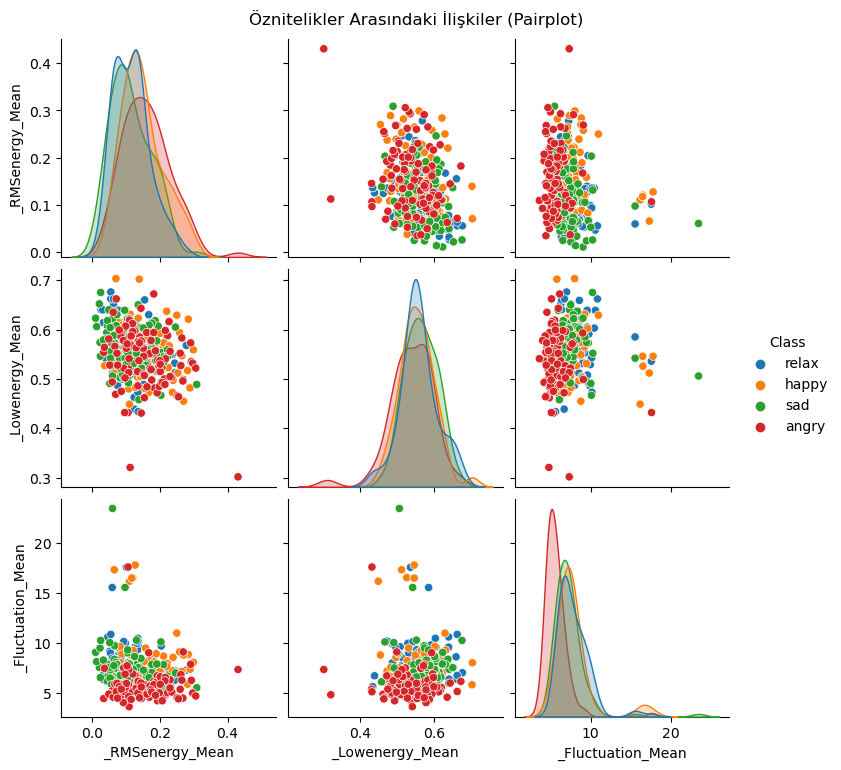

In [16]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Veri setini okuma
file_path = "C:\\Users\\alisa\\Desktop\\Acoustic Features.csv"
df = pd.read_csv(file_path)

# İlginizi çeken belirli sütunları seçme
selected_columns = ['_RMSenergy_Mean', '_Lowenergy_Mean', '_Fluctuation_Mean', 'Class']  # Kendi değişkenlerinizi buraya ekleyin
df_selected = df[selected_columns]

# Pairplot oluşturma ve sınıf değişkenine göre renk kodlama
sns.pairplot(df_selected, hue='Class')
plt.suptitle("Öznitelikler Arasındaki İlişkiler (Pairplot)", y=1.02)
plt.show()


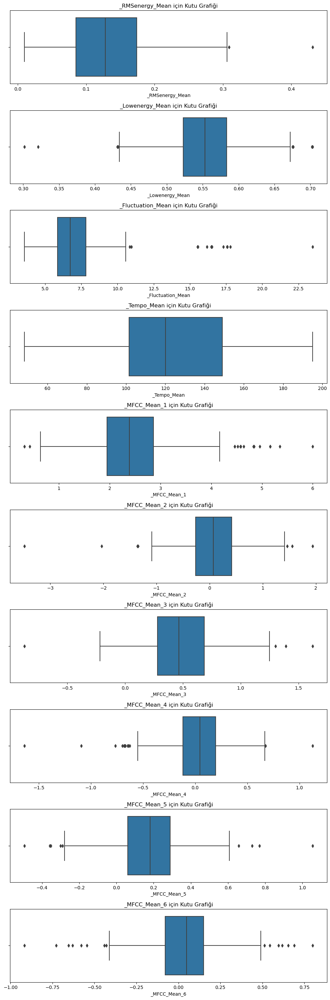

In [21]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Veri setini okuma
file_path = "C:\\Users\\alisa\\Desktop\\Acoustic Features.csv"
df = pd.read_csv(file_path)

# Sütun adlarını seçme ve rastgele 10 sütun seçme
columns = df.columns.tolist()
selected_columns = ['_RMSenergy_Mean', '_Lowenergy_Mean', '_Fluctuation_Mean', '_Tempo_Mean', '_MFCC_Mean_1', '_MFCC_Mean_2', '_MFCC_Mean_3', '_MFCC_Mean_4', '_MFCC_Mean_5', '_MFCC_Mean_6']

# Kutu grafiklerini oluşturma
fig, axes = plt.subplots(nrows=len(selected_columns), ncols=1, figsize=(10, len(selected_columns) * 3))

for i, column in enumerate(selected_columns):
    sns.boxplot(data=df, x=column, ax=axes[i], orient='h')
    axes[i].set_title(f'{column} için Kutu Grafiği')

plt.tight_layout()
plt.show()


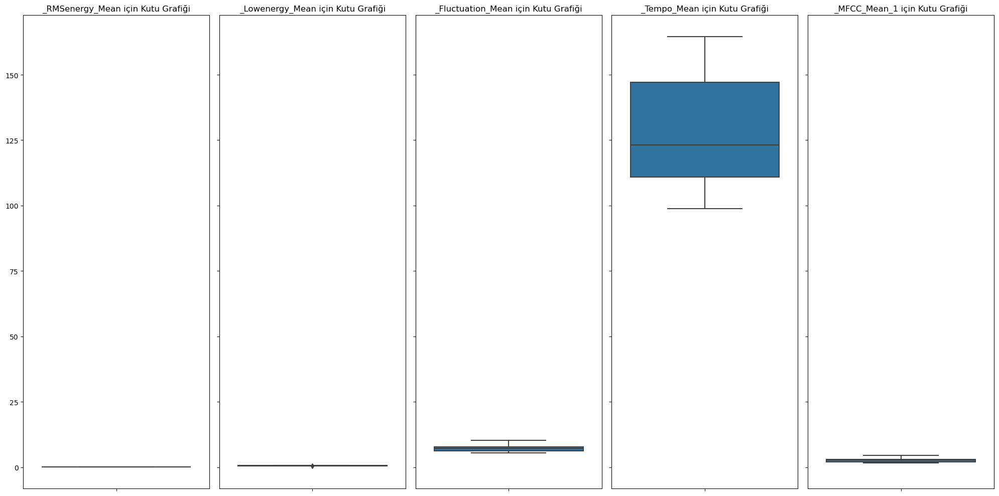

In [25]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Veri setini okuma
file_path = "C:\\Users\\alisa\\Desktop\\Acoustic Features.csv"
df = pd.read_csv(file_path)

# Sütun adlarını seçme ve rastgele 5 sütun seçme
selected_columns = ['_RMSenergy_Mean', '_Lowenergy_Mean', '_Fluctuation_Mean', '_Tempo_Mean', '_MFCC_Mean_1']
df_selected = df[selected_columns].sample(n=10, random_state=42)

# Kutu grafiklerini oluşturma
fig, axes = plt.subplots(nrows=1, ncols=len(selected_columns), figsize=(20, 10), sharey=True)

for i, column in enumerate(selected_columns):
    sns.boxplot(data=df_selected, y=column, ax=axes[i])
    axes[i].set_title(f'{column} için Kutu Grafiği')
    axes[i].set_xlabel('')
    axes[i].set_ylabel('')

plt.tight_layout()
plt.show()


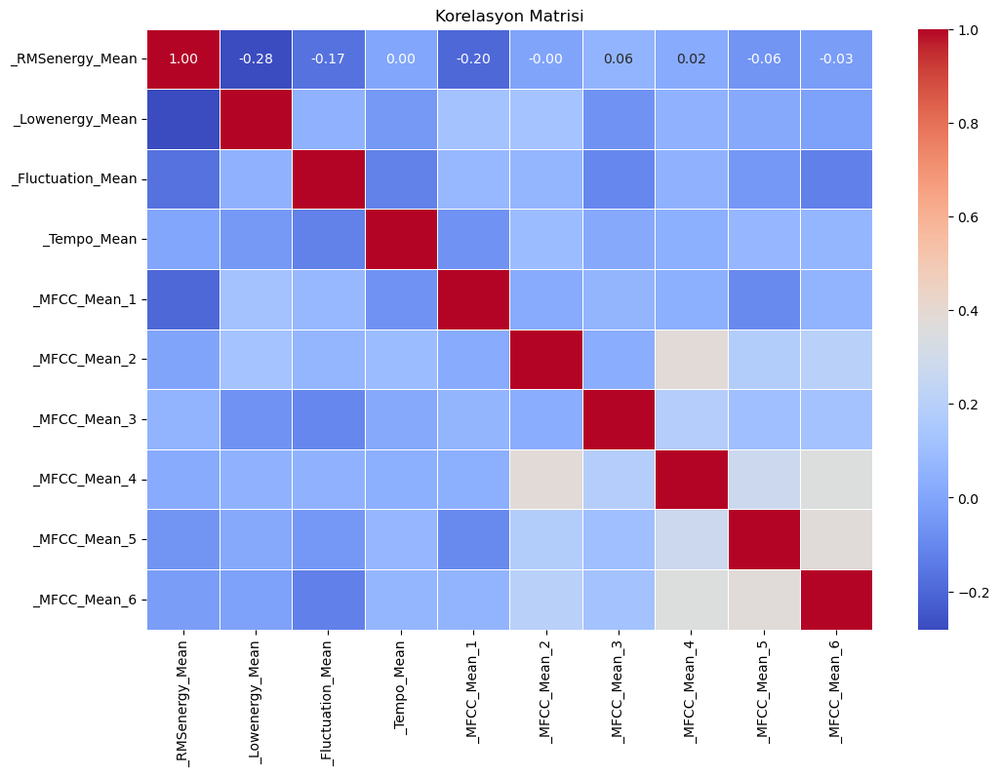

In [26]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Veri setini okuma
file_path = "C:\\Users\\alisa\\Desktop\\Acoustic Features.csv"
df = pd.read_csv(file_path)

# Sütun adlarını seçme ve rastgele 10 sütun seçme
selected_columns = df.columns.tolist()[1:11]  # İlk sütun Class olduğundan atlıyoruz, sonrasında 10 sütun alıyoruz
df_selected = df[selected_columns]

# Korelasyon matrisini hesaplama
corr_matrix = df_selected.corr()

# Korelasyon matrisini görselleştirme
plt.figure(figsize=(12, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=.5)
plt.title('Korelasyon Matrisi')
plt.show()


                                           Feature  Importance
48      _HarmonicChangeDetectionFunction_PeriodAmp    0.094496
45            _HarmonicChangeDetectionFunction_Std    0.081358
19                         _Zero-crossingrate_Mean    0.065537
44           _HarmonicChangeDetectionFunction_Mean    0.063553
2                                _Fluctuation_Mean    0.051788
31                         _EntropyofSpectrum_Mean    0.041730
24                              _Pulseclarity_Mean    0.035969
25                                _Brightness_Mean    0.032968
23                              _Eventdensity_Mean    0.031154
20                                _AttackTime_Mean    0.023275
5                                     _MFCC_Mean_2    0.022251
7                                     _MFCC_Mean_4    0.018681
38                              _Chromagram_Mean_7    0.017644
4                                     _MFCC_Mean_1    0.017574
10                                    _MFCC_Mean_7    0

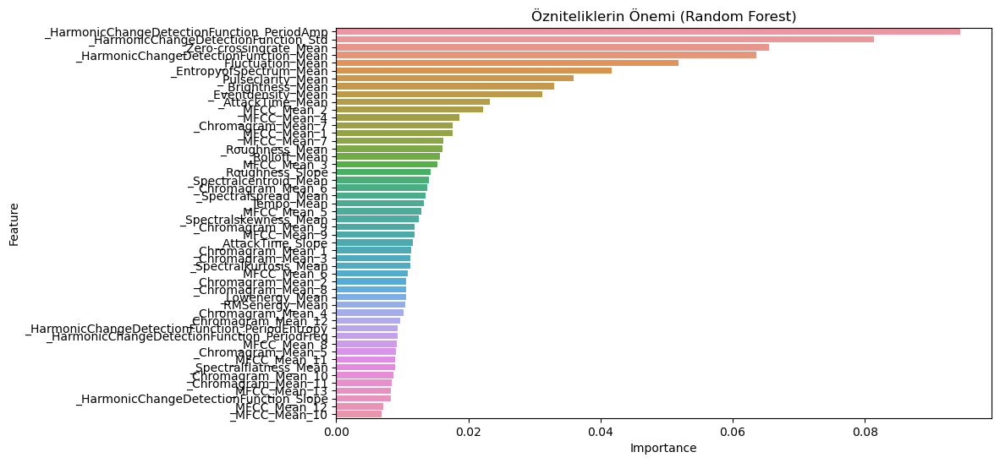

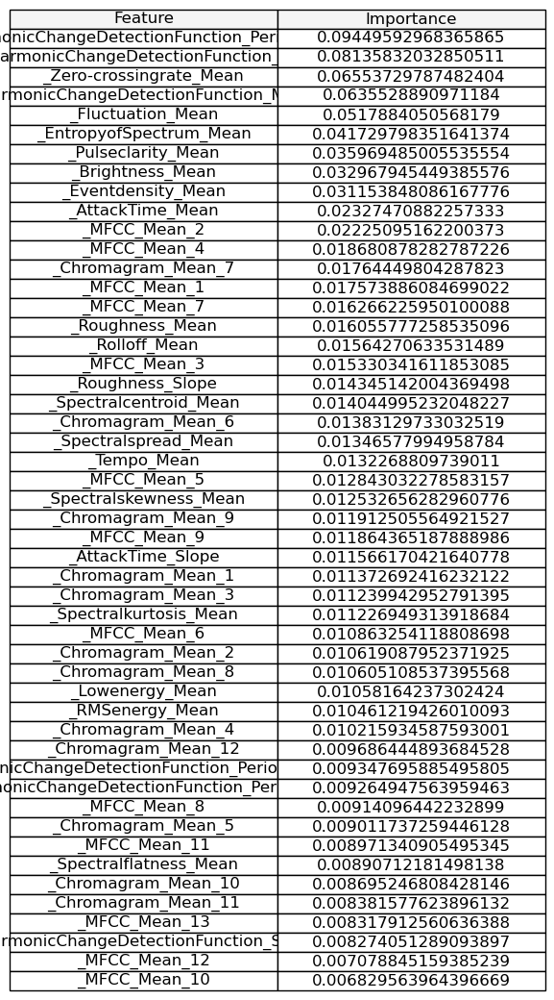

In [28]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt
import seaborn as sns

# Veri setini okuma
file_path = "C:\\Users\\alisa\\Desktop\\Acoustic Features.csv"
df = pd.read_csv(file_path)

# Özellikler ve hedef değişkeni ayırma (burada 'Class' sütunu hedef değişkeni olarak kabul edilmiştir)
X = df.drop('Class', axis=1)
y = df['Class']

# Veri setini eğitim ve test seti olarak ayırma
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Random Forest modeli oluşturma ve eğitme
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

# Öznitelik önemlerini elde etme
feature_importances = rf.feature_importances_

# Öznitelik isimlerini ve önemlerini bir DataFrame'e yerleştirme
feature_importances_df = pd.DataFrame({
    'Feature': X.columns,
    'Importance': feature_importances
})

# Önem değerlerine göre sırala
feature_importances_df = feature_importances_df.sort_values(by='Importance', ascending=False)

# Öznitelik önemlerini gösteren tabloyu yazdırma
print(feature_importances_df)

# Tabloyu görselleştirme
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=feature_importances_df)
plt.title('Özniteliklerin Önemi (Random Forest)')
plt.show()

# Öznitelik önemlerini tablo olarak gösterme
import matplotlib.table as table

# Figür oluşturma
fig, ax = plt.subplots(figsize=(6, 6)) 

# Tablonun oluşturulması ve eklenmesi
tab = table.table(ax, cellText=feature_importances_df.values, colLabels=feature_importances_df.columns, cellLoc = 'center', loc='center', colColours =['#f5f5f5']*2)
tab.auto_set_font_size(False)
tab.set_fontsize(12)
tab.scale(1.2, 1.2)

# Eksenleri kapatma
ax.axis('off')

plt.show()


Aykırı Değerler:
     Class  _RMSenergy_Mean  _Lowenergy_Mean  _Fluctuation_Mean  _Tempo_Mean  \
1    relax            0.125            0.439              6.680      142.240   
5    relax            0.137            0.510              7.664      116.044   
6    relax            0.123            0.533              7.483      136.444   
9    relax            0.129            0.618              8.668       93.020   
13   relax            0.068            0.659              8.580      182.302   
..     ...              ...              ...                ...          ...   
356  angry            0.265            0.583              6.245      180.237   
361  angry            0.069            0.469              4.815      162.193   
367  angry            0.230            0.505              6.279      182.726   
369  angry            0.230            0.556              5.452      140.710   
375  angry            0.182            0.594              5.782      115.081   

     _MFCC_Mean_1  _MF

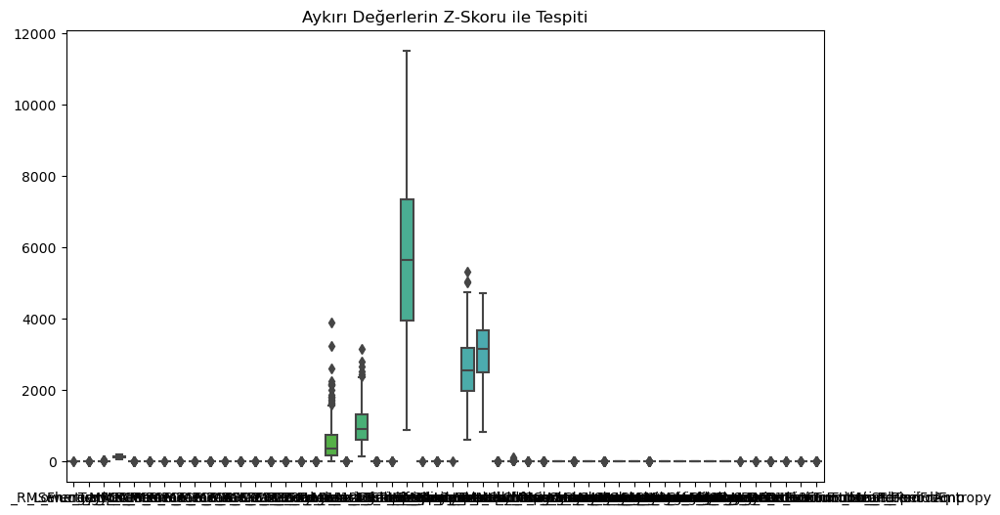

In [29]:
import pandas as pd
import numpy as np

# Veri setini okuma
file_path = "C:\\Users\\alisa\\Desktop\\Acoustic Features.csv"
df = pd.read_csv(file_path)

# Z-skoru hesaplama fonksiyonu
def calculate_z_scores(data):
    z_scores = (data - data.mean()) / data.std()
    return z_scores

# Tüm sütunlar için Z-skorlarını hesaplama
z_scores = calculate_z_scores(df.select_dtypes(include=[np.number]))

# Aykırı değerleri belirleme (Z-skoru > 3 veya Z-skoru < -3)
threshold = 3
outliers = (z_scores > threshold) | (z_scores < -threshold)

# Aykırı değerlerin yer aldığı satırları belirleme
outlier_indices = np.where(outliers.any(axis=1))[0]

# Aykırı değerleri içeren satırları ve Z-skorlarını gösteren DataFrame oluşturma
outlier_df = df.iloc[outlier_indices]
z_scores_outliers = z_scores.iloc[outlier_indices]

# Sonuçları gösterme
print("Aykırı Değerler:")
print(outlier_df)

print("\nBu Değerlerin Z-Skorları:")
print(z_scores_outliers)

# Aykırı değerleri görselleştirme
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 6))
sns.boxplot(data=df.select_dtypes(include=[np.number]))
plt.title("Aykırı Değerlerin Z-Skoru ile Tespiti")
plt.show()


In [30]:
import pandas as pd
import numpy as np

# Veri setini okuma
file_path = "C:\\Users\\alisa\\Desktop\\Acoustic Features.csv"
df = pd.read_csv(file_path)

# Z-skoru hesaplama fonksiyonu
def calculate_z_scores(data):
    z_scores = (data - data.mean()) / data.std()
    return z_scores

# Tüm sütunlar için Z-skorlarını hesaplama
z_scores = calculate_z_scores(df.select_dtypes(include=[np.number]))

# Aykırı değerleri belirleme (Z-skoru > 3 veya Z-skoru < -3)
threshold = 3
outliers = (z_scores > threshold) | (z_scores < -threshold)

# Aykırı değerlerin yer aldığı satırları ve sütunları belirleme
outlier_indices, outlier_columns = np.where(outliers)

# Aykırı değerlerin sayısını belirleme
num_outliers = len(outlier_indices)

# Sonuçları gösterme
print("Aykırı Değerlerin İndeksleri ve Sütunları:")
print(np.where(outliers))

print("\nAykırı Değerlerin Sayısı:")
print(f"Toplam {num_outliers} aykırı değer var.")

print(f"\n{df.shape[0]} Örnekli veri setinde {num_outliers} aykırı değer bulunmuştur.")


Aykırı Değerlerin İndeksleri ve Sütunları:
(array([  1,   5,   5,   6,   6,   9,  13,  13,  21,  22,  22,  22,  24,
        26,  26,  27,  27,  30,  30,  34,  39,  39,  40,  40,  40,  47,
        48,  54,  56,  59,  59,  59,  60,  60,  60,  62,  62,  62,  62,
        62,  62,  62,  79,  82,  82,  88,  88,  89,  89,  89,  90, 102,
       103, 103, 103, 108, 113, 118, 122, 124, 125, 126, 130, 130, 130,
       136, 141, 148, 148, 149, 162, 174, 175, 177, 188, 189, 193, 195,
       198, 198, 199, 202, 202, 202, 202, 202, 205, 207, 211, 211, 216,
       216, 216, 216, 217, 218, 227, 241, 244, 244, 251, 251, 254, 254,
       256, 276, 276, 276, 276, 276, 277, 283, 285, 287, 288, 288, 288,
       288, 288, 288, 288, 289, 290, 303, 303, 303, 308, 310, 311, 320,
       324, 329, 329, 329, 334, 335, 347, 350, 353, 353, 354, 355, 356,
       361, 367, 369, 375], dtype=int64), array([ 9,  9, 46, 28, 31, 45, 45, 49, 35, 28, 29, 48,  9,  9, 11,  6, 21,
        5, 21, 28, 21, 48, 28, 29, 31, 20, 49, 

In [35]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler

# Veri setini okuma
file_path = "C:\\Users\\alisa\\Desktop\\Acoustic Features.csv"
df = pd.read_csv(file_path)

# Sadece sayısal sütunları seçme
numeric_columns = df.select_dtypes(include=[np.number]).columns

# Kısıtlı sütunları seçme
limited_columns = numeric_columns[:10]  # İlk 10 sütunu seçelim
df_limited = df[limited_columns]

# Min-Max Skalası uygulama
scaler = MinMaxScaler()
normalized_data = scaler.fit_transform(df_limited)

# Normalizasyon sonrası veriyi DataFrame'e dönüştürme
normalized_df = pd.DataFrame(normalized_data, columns=limited_columns)

# İlk 5 satırı yazdırma
print("Min-Max Skalası yöntemi kullanılmıştır.\n")

print("Normalizasyon Öncesi Veri Seti:")
print(df_limited.head().to_string(index=False))

print("\nNormalize Edilmiş Veri Seti:")
print(normalized_df.head().to_string(index=False))


Min-Max Skalası yöntemi kullanılmıştır.

Normalizasyon Öncesi Veri Seti:
 _RMSenergy_Mean  _Lowenergy_Mean  _Fluctuation_Mean  _Tempo_Mean  _MFCC_Mean_1  _MFCC_Mean_2  _MFCC_Mean_3  _MFCC_Mean_4  _MFCC_Mean_5  _MFCC_Mean_6
           0.052            0.591              9.136      130.043         3.997         0.363         0.887         0.078         0.221         0.118
           0.125            0.439              6.680      142.240         4.058         0.516         0.785         0.397         0.556         0.799
           0.046            0.639             10.578      188.154         2.775         0.903         0.502         0.329         0.287         0.140
           0.135            0.603             10.442       65.991         2.841         1.552         0.612         0.351         0.011         0.143
           0.066            0.591              9.769       88.890         3.217         0.228         0.814         0.096         0.434         0.285

Normalize Edilmiş Veri Set

En iyi k değeri: 5 ile doğruluk: 0.56

En iyi k değeri (5) için KNN Sınıflandırma Raporu:

              precision    recall  f1-score   support

       angry       0.56      0.78      0.65        18
       happy       0.56      1.00      0.72        18
       relax       0.60      0.35      0.44        26
         sad       0.50      0.22      0.31        18

    accuracy                           0.56        80
   macro avg       0.56      0.59      0.53        80
weighted avg       0.56      0.56      0.52        80



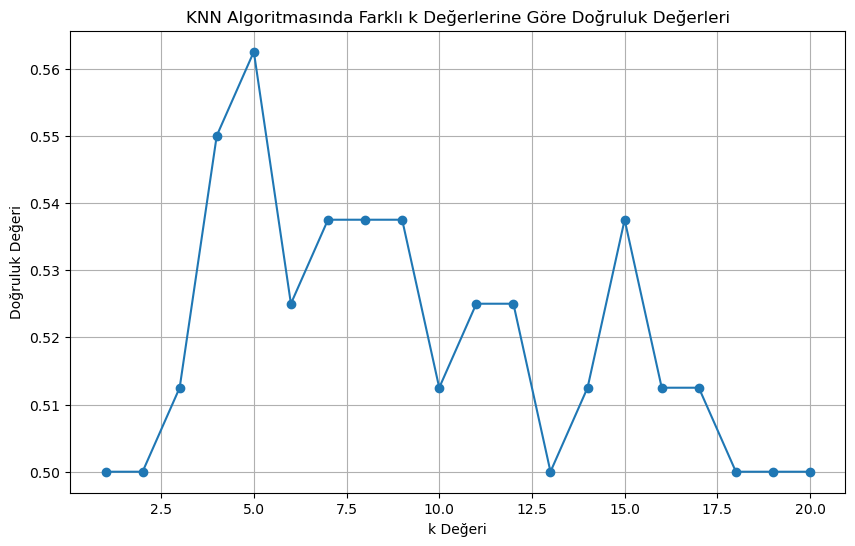

In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import MinMaxScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report, accuracy_score
import matplotlib.pyplot as plt

# Veri setini okuma
file_path = "C:\\Users\\alisa\\Desktop\\Acoustic Features.csv"
df = pd.read_csv(file_path)

# Özellikler ve hedef değişkeni ayırma (burada 'Class' sütunu hedef değişkeni olarak kabul edilmiştir)
X = df.drop('Class', axis=1)
y = df['Class']

# Sadece sayısal sütunları seçme ve normalizasyon uygulama
numeric_columns = X.select_dtypes(include=[np.number]).columns
scaler = MinMaxScaler()
X[numeric_columns] = scaler.fit_transform(X[numeric_columns])

# Veri setini eğitim ve test seti olarak ayırma
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Farklı k değerleri için KNN modelleri oluşturma ve doğruluk hesaplama
k_values = range(1, 21)
accuracies = []

for k in k_values:
    knn = KNeighborsClassifier(n_neighbors=k)
    knn.fit(X_train, y_train)
    y_pred = knn.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    accuracies.append(accuracy)

# En iyi k değerini bulma
best_k = k_values[np.argmax(accuracies)]
best_accuracy = max(accuracies)

print(f"En iyi k değeri: {best_k} ile doğruluk: {best_accuracy:.2f}")

# En iyi k değeri için sınıflandırma raporu
best_knn = KNeighborsClassifier(n_neighbors=best_k)
best_knn.fit(X_train, y_train)
y_pred = best_knn.predict(X_test)

class_labels = y.unique()
class_labels.sort()
class_report = classification_report(y_test, y_pred, target_names=[str(label) for label in class_labels])
print(f"\nEn iyi k değeri ({best_k}) için KNN Sınıflandırma Raporu:\n")
print(class_report)

# Doğruluk değerlerini grafikle gösterme
plt.figure(figsize=(10, 6))
plt.plot(k_values, accuracies, marker='o')
plt.title('KNN Algoritmasında Farklı k Değerlerine Göre Doğruluk Değerleri')
plt.xlabel('k Değeri')
plt.ylabel('Doğruluk Değeri')
plt.grid(True)
plt.show()


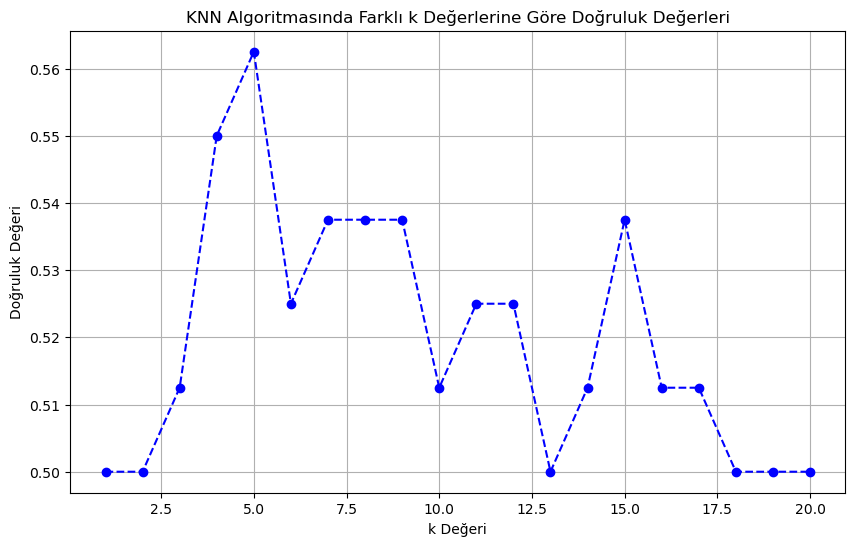

In [38]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt

# Veri setini okuma
file_path = "C:\\Users\\alisa\\Desktop\\Acoustic Features.csv"
df = pd.read_csv(file_path)

# Özellikler ve hedef değişkeni ayırma (burada 'Class' sütunu hedef değişkeni olarak kabul edilmiştir)
X = df.drop('Class', axis=1)
y = df['Class']

# Sadece sayısal sütunları seçme ve normalizasyon uygulama
numeric_columns = X.select_dtypes(include=[np.number]).columns
scaler = MinMaxScaler()
X[numeric_columns] = scaler.fit_transform(X[numeric_columns])

# Veri setini eğitim ve test seti olarak ayırma
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# KNN algoritması için k değerlerini belirleme
k_values = range(1, 21)
accuracies = []

# Farklı k değerleri için KNN modeli oluşturma ve doğruluğu hesaplama
for k in k_values:
    knn = KNeighborsClassifier(n_neighbors=k)
    knn.fit(X_train, y_train)
    y_pred = knn.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    accuracies.append(accuracy)

# Doğruluk değerlerini görselleştirme
plt.figure(figsize=(10, 6))
plt.plot(k_values, accuracies, marker='o', linestyle='--', color='b')
plt.title('KNN Algoritmasında Farklı k Değerlerine Göre Doğruluk Değerleri')
plt.xlabel('k Değeri')
plt.ylabel('Doğruluk Değeri')
plt.grid()
plt.show()


In [40]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import classification_report, accuracy_score

# Veri setini okuma
file_path = "C:\\Users\\alisa\\Desktop\\Acoustic Features.csv"
df = pd.read_csv(file_path)

# Özellikler ve hedef değişkeni ayırma (burada 'Class' sütunu hedef değişkeni olarak kabul edilmiştir)
X = df.drop('Class', axis=1)
y = df['Class']

# Sadece sayısal sütunları seçme ve normalizasyon uygulama
numeric_columns = X.select_dtypes(include=[np.number]).columns
scaler = MinMaxScaler()
X[numeric_columns] = scaler.fit_transform(X[numeric_columns])

# Veri setini eğitim ve test seti olarak ayırma
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Naive Bayes modeli oluşturma ve eğitme
nb = GaussianNB()
nb.fit(X_train, y_train)

# Test seti üzerinde tahmin yapma
y_pred = nb.predict(X_test)

# Model doğruluğunu hesaplama
accuracy = accuracy_score(y_test, y_pred)
print(f"Naive Bayes Model Doğruluğu: {accuracy:.2f}")

# Sınıf etiketlerini belirleme
class_labels = y.unique()
class_labels.sort()

# Sınıflandırma raporunu oluşturma
class_report = classification_report(y_test, y_pred, target_names=[str(label) for label in class_labels])
print("\nNaive Bayes Sınıflandırma Raporu:\n")
print(class_report)


Naive Bayes Model Doğruluğu: 0.76

Naive Bayes Sınıflandırma Raporu:

              precision    recall  f1-score   support

       angry       0.73      0.61      0.67        18
       happy       0.68      0.94      0.79        18
       relax       0.83      0.92      0.87        26
         sad       0.82      0.50      0.62        18

    accuracy                           0.76        80
   macro avg       0.76      0.74      0.74        80
weighted avg       0.77      0.76      0.75        80



In [41]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report, accuracy_score

# Veri setini okuma
file_path = "C:\\Users\\alisa\\Desktop\\Acoustic Features.csv"
df = pd.read_csv(file_path)

# Özellikler ve hedef değişkeni ayırma (burada 'Class' sütunu hedef değişkeni olarak kabul edilmiştir)
X = df.drop('Class', axis=1)
y = df['Class']

# Sadece sayısal sütunları seçme ve normalizasyon uygulama
numeric_columns = X.select_dtypes(include=[np.number]).columns
scaler = MinMaxScaler()
X[numeric_columns] = scaler.fit_transform(X[numeric_columns])

# Veri setini eğitim ve test seti olarak ayırma
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Karar Ağacı modeli oluşturma ve eğitme
dt = DecisionTreeClassifier(random_state=42)
dt.fit(X_train, y_train)

# Test seti üzerinde tahmin yapma
y_pred = dt.predict(X_test)

# Model doğruluğunu hesaplama
accuracy = accuracy_score(y_test, y_pred)
print(f"Karar Ağacı Model Doğruluğu: {accuracy:.2f}")

# Sınıf etiketlerini belirleme
class_labels = y.unique()
class_labels.sort()

# Sınıflandırma raporunu oluşturma
class_report = classification_report(y_test, y_pred, target_names=[str(label) for label in class_labels])
print("\nKarar Ağacı Sınıflandırma Raporu:\n")
print(class_report)


Karar Ağacı Model Doğruluğu: 0.61

Karar Ağacı Sınıflandırma Raporu:

              precision    recall  f1-score   support

       angry       0.71      0.56      0.63        18
       happy       0.67      0.78      0.72        18
       relax       0.64      0.54      0.58        26
         sad       0.48      0.61      0.54        18

    accuracy                           0.61        80
   macro avg       0.62      0.62      0.62        80
weighted avg       0.63      0.61      0.61        80



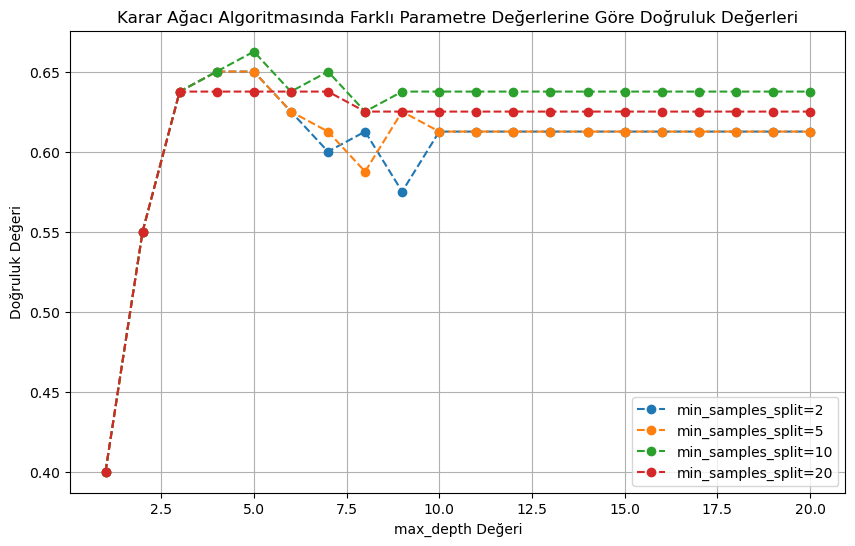

In [42]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt

# Veri setini okuma
file_path = "C:\\Users\\alisa\\Desktop\\Acoustic Features.csv"
df = pd.read_csv(file_path)

# Özellikler ve hedef değişkeni ayırma (burada 'Class' sütunu hedef değişkeni olarak kabul edilmiştir)
X = df.drop('Class', axis=1)
y = df['Class']

# Sadece sayısal sütunları seçme ve normalizasyon uygulama
numeric_columns = X.select_dtypes(include=[np.number]).columns
scaler = MinMaxScaler()
X[numeric_columns] = scaler.fit_transform(X[numeric_columns])

# Veri setini eğitim ve test seti olarak ayırma
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Parametre değerlerini belirleme
max_depth_values = range(1, 21)
min_samples_split_values = [2, 5, 10, 20]
accuracies = {split: [] for split in min_samples_split_values}

# Farklı parametre değerleri için Karar Ağacı modeli oluşturma ve doğruluğu hesaplama
for min_samples_split in min_samples_split_values:
    for max_depth in max_depth_values:
        dt = DecisionTreeClassifier(max_depth=max_depth, min_samples_split=min_samples_split, random_state=42)
        dt.fit(X_train, y_train)
        y_pred = dt.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred)
        accuracies[min_samples_split].append(accuracy)

# Doğruluk değerlerini görselleştirme
plt.figure(figsize=(10, 6))
for min_samples_split in min_samples_split_values:
    plt.plot(max_depth_values, accuracies[min_samples_split], marker='o', linestyle='--', label=f'min_samples_split={min_samples_split}')

plt.title('Karar Ağacı Algoritmasında Farklı Parametre Değerlerine Göre Doğruluk Değerleri')
plt.xlabel('max_depth Değeri')
plt.ylabel('Doğruluk Değeri')
plt.legend()
plt.grid()
plt.show()


In [43]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score

# Veri setini okuma
file_path = "C:\\Users\\alisa\\Desktop\\Acoustic Features.csv"
df = pd.read_csv(file_path)

# Özellikler ve hedef değişkeni ayırma (burada 'Class' sütunu hedef değişkeni olarak kabul edilmiştir)
X = df.drop('Class', axis=1)
y = df['Class']

# Sadece sayısal sütunları seçme ve normalizasyon uygulama
numeric_columns = X.select_dtypes(include=[np.number]).columns
scaler = MinMaxScaler()
X[numeric_columns] = scaler.fit_transform(X[numeric_columns])

# Veri setini eğitim ve test seti olarak ayırma
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Random Forest modeli oluşturma ve eğitme
rf = RandomForestClassifier(random_state=42)
rf.fit(X_train, y_train)

# Test seti üzerinde tahmin yapma
y_pred = rf.predict(X_test)

# Model doğruluğunu hesaplama
accuracy = accuracy_score(y_test, y_pred)
print(f"Random Forest Model Doğruluğu: {accuracy:.2f}")

# Sınıf etiketlerini belirleme
class_labels = y.unique()
class_labels.sort()

# Sınıflandırma raporunu oluşturma
class_report = classification_report(y_test, y_pred, target_names=[str(label) for label in class_labels])
print("\nRandom Forest Sınıflandırma Raporu:\n")
print(class_report)


Random Forest Model Doğruluğu: 0.82

Random Forest Sınıflandırma Raporu:

              precision    recall  f1-score   support

       angry       0.94      0.83      0.88        18
       happy       0.81      0.94      0.87        18
       relax       0.88      0.81      0.84        26
         sad       0.68      0.72      0.70        18

    accuracy                           0.82        80
   macro avg       0.83      0.83      0.82        80
weighted avg       0.83      0.82      0.83        80



In [44]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, accuracy_score

# Veri setini okuma
file_path = "C:\\Users\\alisa\\Desktop\\Acoustic Features.csv"
df = pd.read_csv(file_path)

# Özellikler ve hedef değişkeni ayırma (burada 'Class' sütunu hedef değişkeni olarak kabul edilmiştir)
X = df.drop('Class', axis=1)
y = df['Class']

# Sadece sayısal sütunları seçme ve normalizasyon uygulama
numeric_columns = X.select_dtypes(include=[np.number]).columns
scaler = MinMaxScaler()
X[numeric_columns] = scaler.fit_transform(X[numeric_columns])

# Veri setini eğitim ve test seti olarak ayırma
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Lojistik Regresyon modeli oluşturma ve eğitme
lr = LogisticRegression(random_state=42, max_iter=10000)
lr.fit(X_train, y_train)

# Test seti üzerinde tahmin yapma
y_pred = lr.predict(X_test)

# Model doğruluğunu hesaplama
accuracy = accuracy_score(y_test, y_pred)
print(f"Lojistik Regresyon Model Doğruluğu: {accuracy:.2f}")

# Sınıf etiketlerini belirleme
class_labels = y.unique()
class_labels.sort()

# Sınıflandırma raporunu oluşturma
class_report = classification_report(y_test, y_pred, target_names=[str(label) for label in class_labels])
print("\nLojistik Regresyon Sınıflandırma Raporu:\n")
print(class_report)


Lojistik Regresyon Model Doğruluğu: 0.74

Lojistik Regresyon Sınıflandırma Raporu:

              precision    recall  f1-score   support

       angry       0.80      0.67      0.73        18
       happy       0.81      0.94      0.87        18
       relax       0.78      0.81      0.79        26
         sad       0.53      0.50      0.51        18

    accuracy                           0.74        80
   macro avg       0.73      0.73      0.73        80
weighted avg       0.73      0.74      0.73        80



Naive Bayes Model Doğruluğu: 0.76

Naive Bayes Sınıflandırma Raporu:

              precision    recall  f1-score   support

       angry       0.73      0.61      0.67        18
       happy       0.68      0.94      0.79        18
       relax       0.83      0.92      0.87        26
         sad       0.82      0.50      0.62        18

    accuracy                           0.76        80
   macro avg       0.76      0.74      0.74        80
weighted avg       0.77      0.76      0.75        80



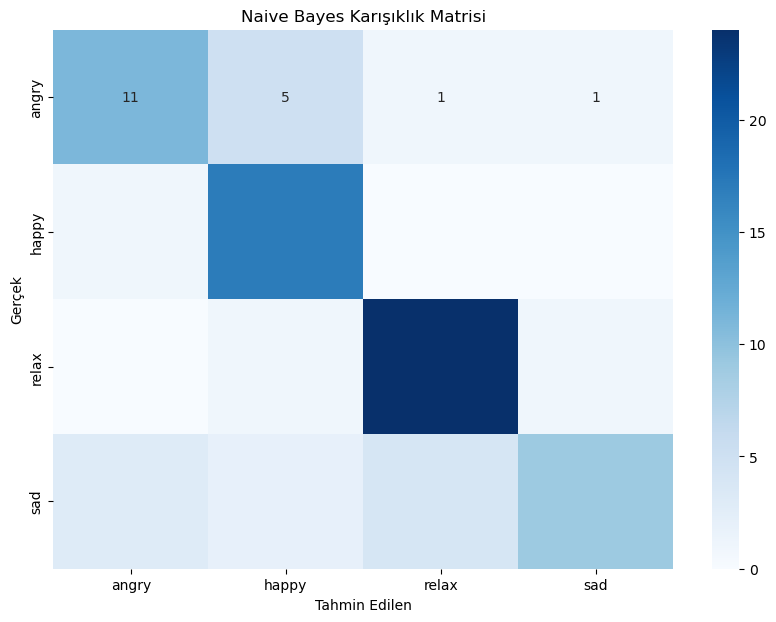

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


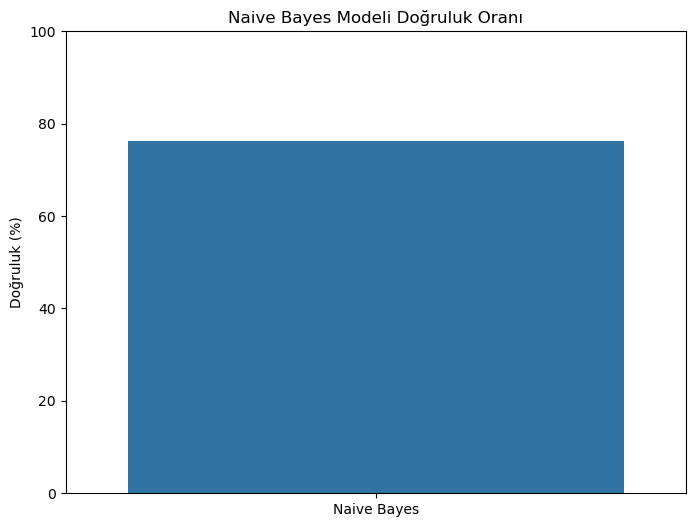

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix

# Veri setini okuma
file_path = "C:\\Users\\alisa\\Desktop\\Acoustic Features.csv"
df = pd.read_csv(file_path)

# Özellikler ve hedef değişkeni ayırma (burada 'Class' sütunu hedef değişkeni olarak kabul edilmiştir)
X = df.drop('Class', axis=1)
y = df['Class']

# Sadece sayısal sütunları seçme ve normalizasyon uygulama
numeric_columns = X.select_dtypes(include=[np.number]).columns
scaler = MinMaxScaler()
X[numeric_columns] = scaler.fit_transform(X[numeric_columns])

# Veri setini eğitim ve test seti olarak ayırma
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Naive Bayes modeli oluşturma ve eğitme
nb = GaussianNB()
nb.fit(X_train, y_train)

# Test seti üzerinde tahmin yapma
y_pred = nb.predict(X_test)

# Model doğruluğunu hesaplama
accuracy = accuracy_score(y_test, y_pred)
print(f"Naive Bayes Model Doğruluğu: {accuracy:.2f}")

# Sınıf etiketlerini belirleme
class_labels = y.unique()
class_labels.sort()

# Sınıflandırma raporunu oluşturma
class_report = classification_report(y_test, y_pred, target_names=[str(label) for label in class_labels])
print("\nNaive Bayes Sınıflandırma Raporu:\n")
print(class_report)

# Karışıklık matrisi oluşturma
cm = confusion_matrix(y_test, y_pred)

# Karışıklık matrisini görselleştirme
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Tahmin Edilen')
plt.ylabel('Gerçek')
plt.title('Naive Bayes Karışıklık Matrisi')
plt.show()

# Doğruluk oranını gösteren bar grafiği
plt.figure(figsize=(8, 6))
sns.barplot(x=['Naive Bayes'], y=[accuracy * 100])
plt.ylim(0, 100)
plt.title('Naive Bayes Modeli Doğruluk Oranı')
plt.ylabel('Doğruluk (%)')
plt.show()


Random Forest Model Doğruluğu: 0.82


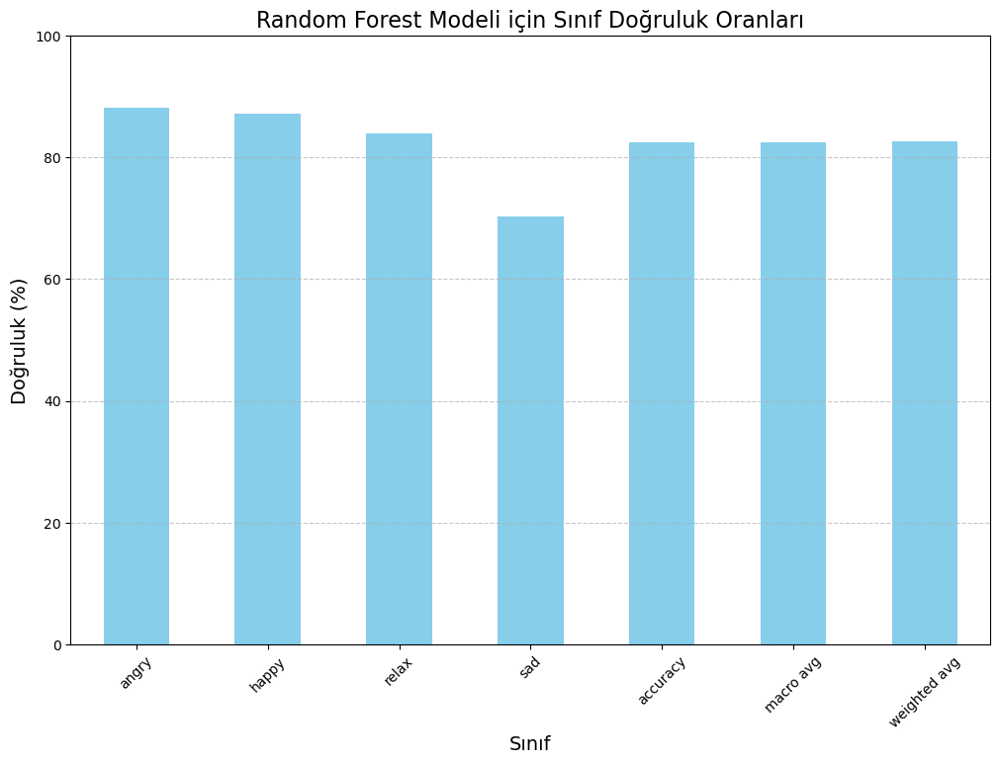

In [8]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score

# Veri setini okuma
file_path = "C:\\Users\\alisa\\Desktop\\Acoustic Features.csv"
df = pd.read_csv(file_path)

# Özellikler ve hedef değişkeni ayırma (burada 'Class' sütunu hedef değişkeni olarak kabul edilmiştir)
X = df.drop('Class', axis=1)
y = df['Class']

# Sadece sayısal sütunları seçme ve normalizasyon uygulama
numeric_columns = X.select_dtypes(include=[np.number]).columns
scaler = MinMaxScaler()
X[numeric_columns] = scaler.fit_transform(X[numeric_columns])

# Veri setini eğitim ve test seti olarak ayırma
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Random Forest modeli oluşturma ve eğitme
rf = RandomForestClassifier(random_state=42)
rf.fit(X_train, y_train)

# Test seti üzerinde tahmin yapma
y_pred = rf.predict(X_test)

# Model doğruluğunu hesaplama
accuracy = accuracy_score(y_test, y_pred)
print(f"Random Forest Model Doğruluğu: {accuracy:.2f}")

# Sınıflandırma raporunu oluşturma
class_labels = y.unique()
class_labels.sort()
class_report = classification_report(y_test, y_pred, target_names=[str(label) for label in class_labels], output_dict=True)

# Doğruluk değerlerini bir DataFrame olarak görüntüleyelim
accuracy_df = pd.DataFrame(class_report).transpose()

# Genel doğruluk oranını ekleyelim
accuracy_df.loc['genel doğruluk'] = accuracy

# Doğruluk değerlerini yüzdeler halinde gösterelim
accuracy_df['doğruluk (%)'] = accuracy_df['f1-score'] * 100

# Sınıfların doğruluk oranlarını çubuk grafikle görselleştirme
plt.figure(figsize=(12, 8))
accuracy_df.iloc[:-1]['doğruluk (%)'].plot(kind='bar', color='skyblue')
plt.title('Random Forest Modeli için Sınıf Doğruluk Oranları', fontsize=16)
plt.xlabel('Sınıf', fontsize=14)
plt.ylabel('Doğruluk (%)', fontsize=14)
plt.ylim(0, 100)
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


Lojistik Regresyon Model Doğruluğu: 0.74

Lojistik Regresyon Sınıflandırma Raporu:

              precision    recall  f1-score   support

       angry       0.80      0.67      0.73        18
       happy       0.81      0.94      0.87        18
       relax       0.78      0.81      0.79        26
         sad       0.53      0.50      0.51        18

    accuracy                           0.74        80
   macro avg       0.73      0.73      0.73        80
weighted avg       0.73      0.74      0.73        80



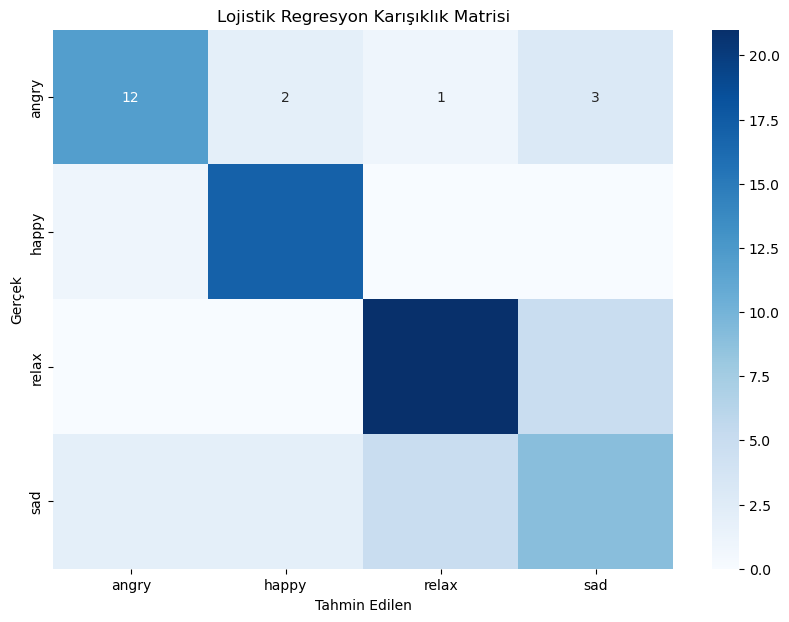

In [10]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Veri setini okuma
file_path = "C:\\Users\\alisa\\Desktop\\Acoustic Features.csv"
df = pd.read_csv(file_path)

# Özellikler ve hedef değişkeni ayırma (burada 'Class' sütunu hedef değişkeni olarak kabul edilmiştir)
X = df.drop('Class', axis=1)
y = df['Class']

# Sadece sayısal sütunları seçme ve normalizasyon uygulama
numeric_columns = X.select_dtypes(include=[np.number]).columns
scaler = MinMaxScaler()
X[numeric_columns] = scaler.fit_transform(X[numeric_columns])

# Veri setini eğitim ve test seti olarak ayırma
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Lojistik Regresyon modeli oluşturma ve eğitme
lr = LogisticRegression(random_state=42, max_iter=10000)
lr.fit(X_train, y_train)

# Test seti üzerinde tahmin yapma
y_pred = lr.predict(X_test)

# Model doğruluğunu hesaplama
accuracy = accuracy_score(y_test, y_pred)
print(f"Lojistik Regresyon Model Doğruluğu: {accuracy:.2f}")

# Sınıf etiketlerini belirleme
class_labels = y.unique()
class_labels.sort()

# Sınıflandırma raporunu oluşturma
class_report = classification_report(y_test, y_pred, target_names=[str(label) for label in class_labels])
print("\nLojistik Regresyon Sınıflandırma Raporu:\n")
print(class_report)

# Confusion Matrix'i hesaplama
cm = confusion_matrix(y_test, y_pred)

# Confusion Matrix'i görselleştirme
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Tahmin Edilen')
plt.ylabel('Gerçek')
plt.title('Lojistik Regresyon Karışıklık Matrisi')
plt.show()
